# Explore data augmentations

This notebook will be used to test different data augmentation strategies. In your config file, you can modify the augmentations by adding `data_augmentation_options`. For example, I would like to add a random RGB to gray transform with a probability of 0.2:
```
data_augmentation_options {
    random_rgb_to_gray {
    probability: 0.2
    }
```

A complete list of augmentation is provided the [`preprocessor.proto` file of the Tf Object Detection API](https://github.com/tensorflow/models/blob/master/research/object_detection/protos/preprocessor.proto).

### Helper functions

In [17]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

In [18]:
def recenter_image(image):
    # ssd preprocessing
    image += [123.68, 116.779, 103.939]
    return image

def display_instances(image, bboxes, classes):
    image = recenter_image(image)
    w, h, _ = image.shape
    # resize the bboxes
    bboxes[:, [0, 2]] *= w
    bboxes[:, [1, 3]] *= h
    
    f, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(image.astype(np.uint8))
    for bb, cl in zip(bboxes, classes):
        y1, x1, y2, x2 = bb
        rec = Rectangle((x1, y1), x2-x1, y2-y1, facecolor='none', edgecolor='r', linewidth=2)
        ax.add_patch(rec)
    plt.show()

def display_batch(batch):
    # get images, bboxes and classes
    batched_images = batch[0]['image'].numpy()
    batched_bboxes = batch[1]['groundtruth_boxes'].numpy()
    batched_classes = batch[1]['groundtruth_classes'].numpy()
    num_bboxes = batch[1]['num_groundtruth_boxes'].numpy()
    batch_size = batched_images.shape[0]
    for idx in range(batch_size):
        display_instances(batched_images[idx, ...], 
                          batched_bboxes[idx, :num_bboxes[idx], :],
                          batched_classes[idx, ...])

### Display augmentations

In [19]:
from utils import get_train_input

In [20]:
non_augmentation = get_train_input("./experiments/reference/pipeline_new.config")
experiments0 = get_train_input("./experiments/experiment0/reference/pipeline_new.config")
experiments1 = get_train_input("./experiments/experiment1/reference/pipeline_new.config")
experiments2 = get_train_input("./experiments/experiment2/reference/pipeline_new.config")
experiments3 = get_train_input("./experiments/experiment3/reference/pipeline_new.config")
experiments4 = get_train_input("./experiments/experiment4/reference/pipeline_new.config")

INFO:tensorflow:Reading unweighted datasets: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tfrecord', '/

INFO:tensorflow:Reading record datasets for input file: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tf

INFO:tensorflow:Number of filenames to read: 75
INFO:tensorflow:Reading unweighted datasets: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_63

INFO:tensorflow:Reading record datasets for input file: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tf

INFO:tensorflow:Number of filenames to read: 75
INFO:tensorflow:Reading unweighted datasets: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_63

INFO:tensorflow:Reading record datasets for input file: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tf

INFO:tensorflow:Number of filenames to read: 75
INFO:tensorflow:Reading unweighted datasets: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_63

INFO:tensorflow:Reading record datasets for input file: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tf

INFO:tensorflow:Number of filenames to read: 75
INFO:tensorflow:Reading unweighted datasets: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_63

INFO:tensorflow:Reading record datasets for input file: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tf

INFO:tensorflow:Number of filenames to read: 75
INFO:tensorflow:Reading unweighted datasets: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_63

INFO:tensorflow:Reading record datasets for input file: ['/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10964956617027590844_1584_680_1604_680_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-12161824480686739258_1813_380_1833_380_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10072140764565668044_4060_000_4080_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10770759614217273359_1465_000_1485_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10723911392655396041_860_000_880_000_with_camera_labels.tfrecord', '/home/antonio/Proyectos/Desarrollo/Nano-Degree/object-detection/data/waymo/train/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tf

INFO:tensorflow:Number of filenames to read: 75


## Non Augmentation Results

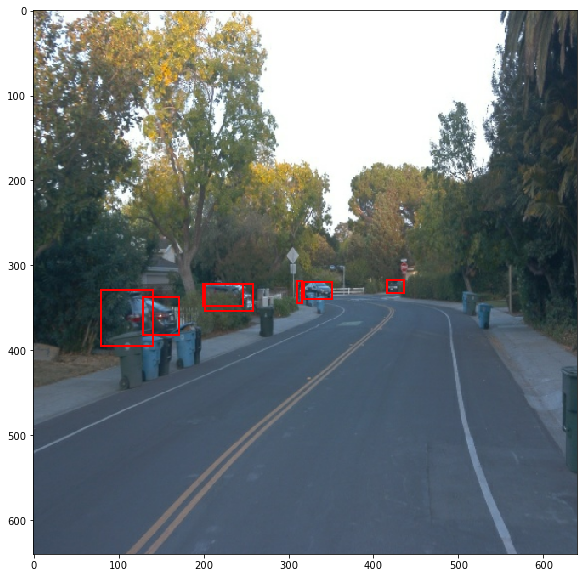

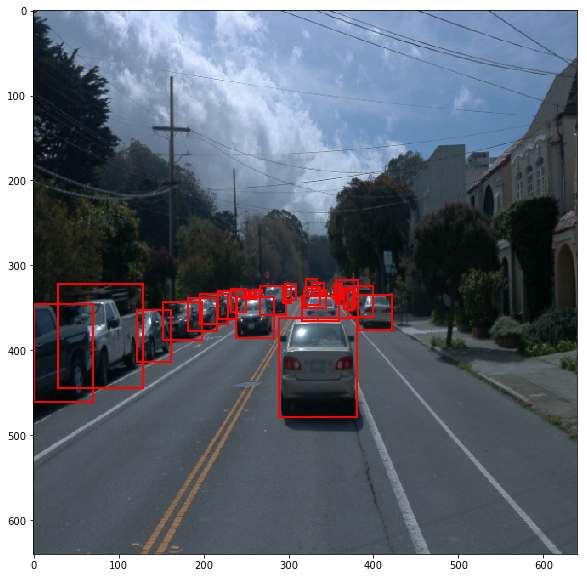

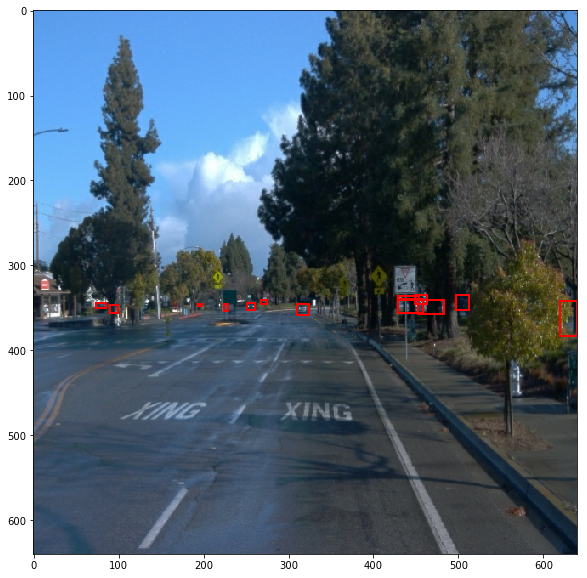

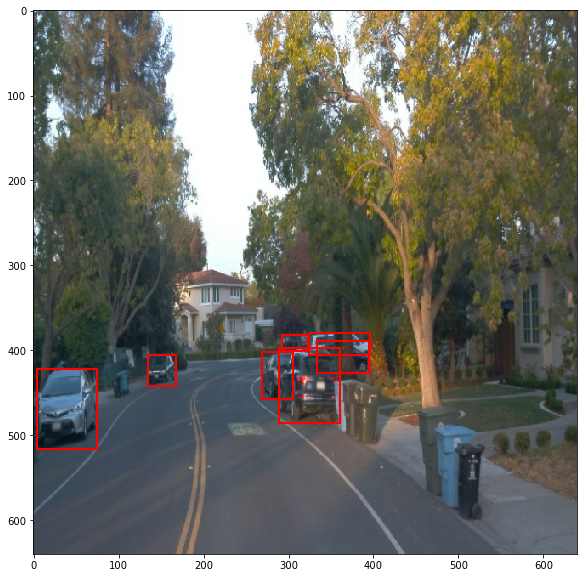

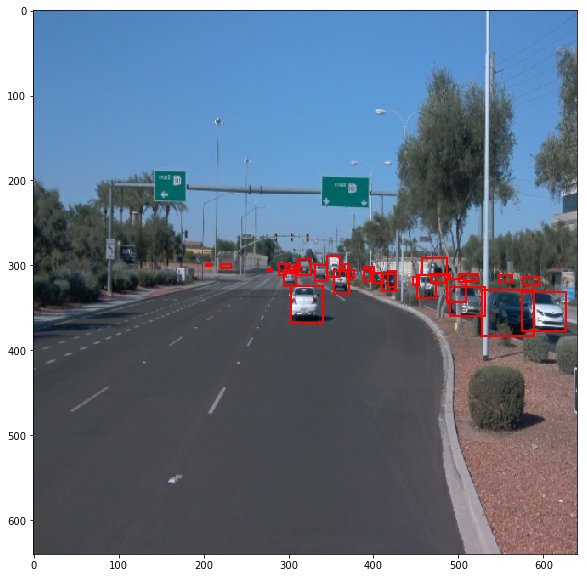

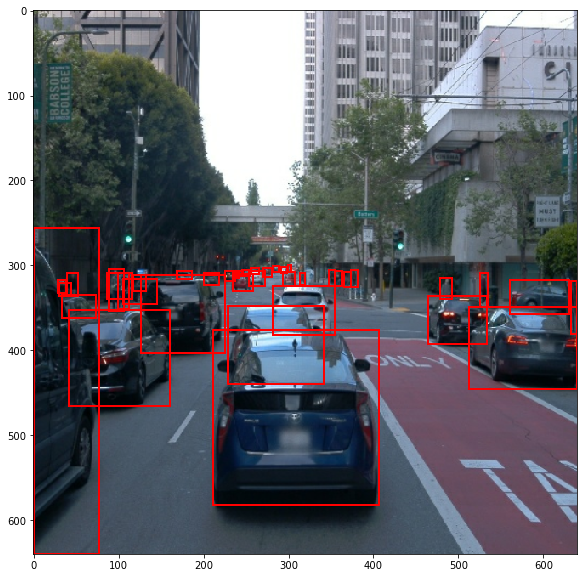

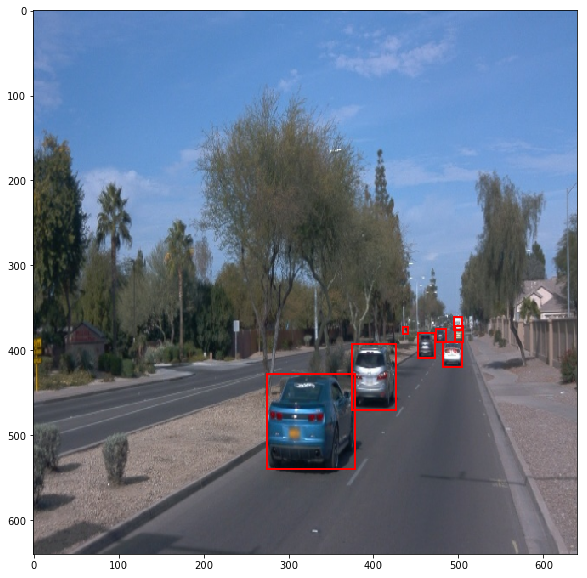

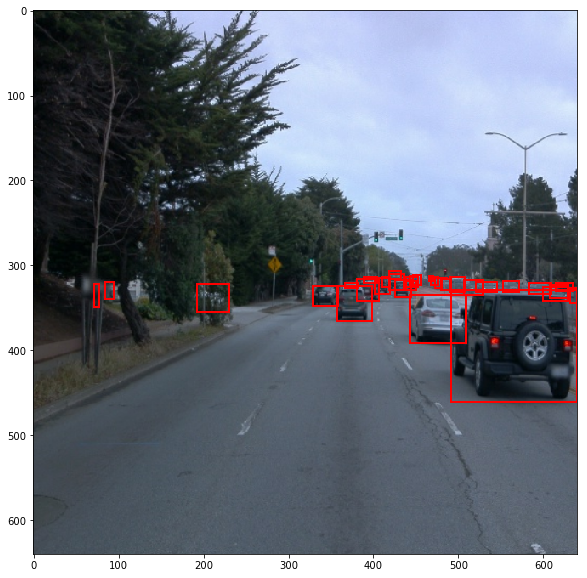

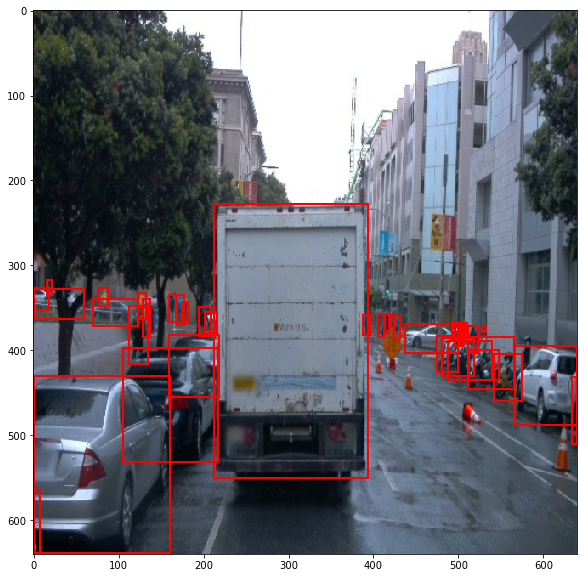

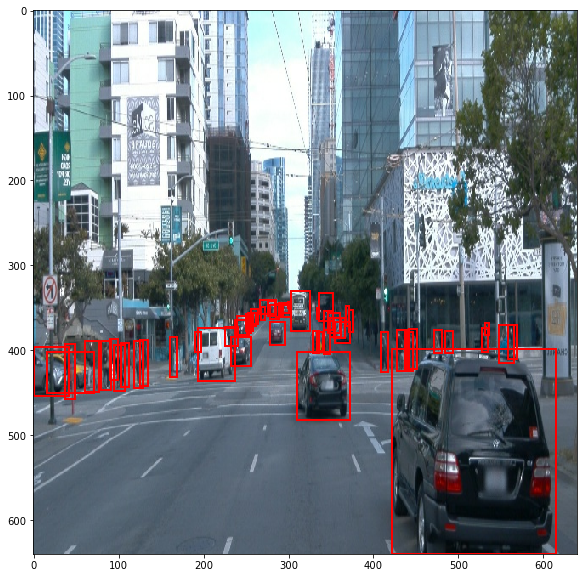

In [21]:
%matplotlib inline

for batch in non_augmentation.take(5):
    display_batch(batch)

## Experiment 0 Results

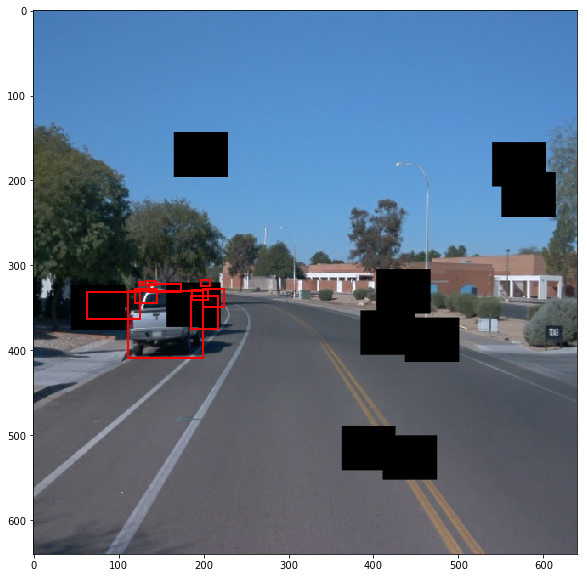

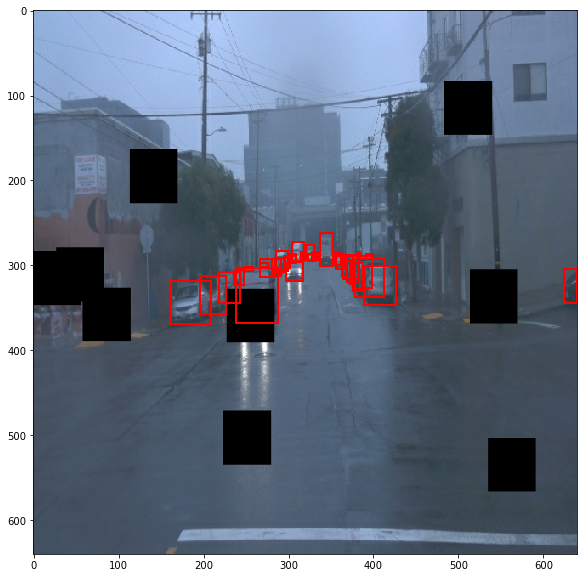

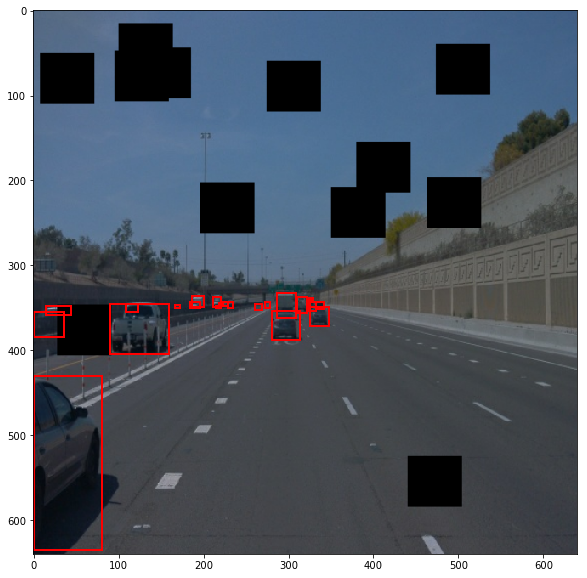

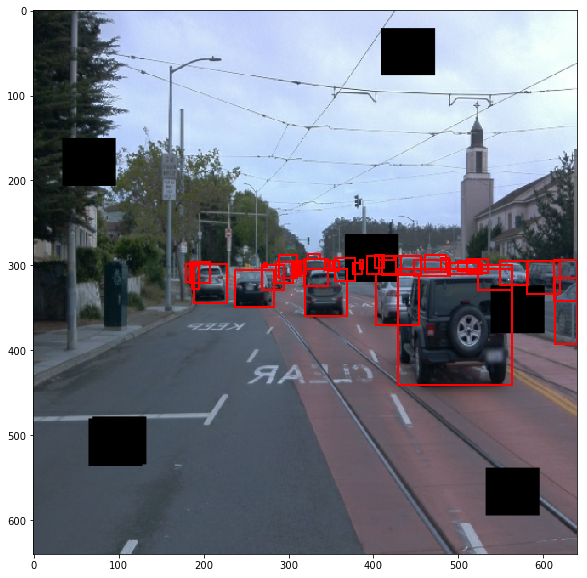

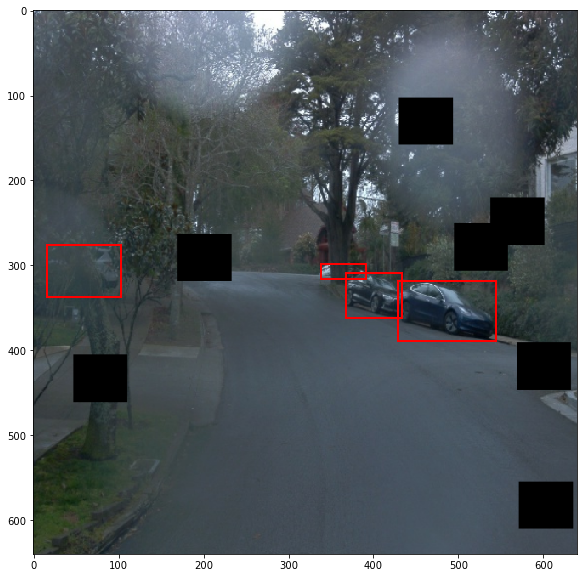

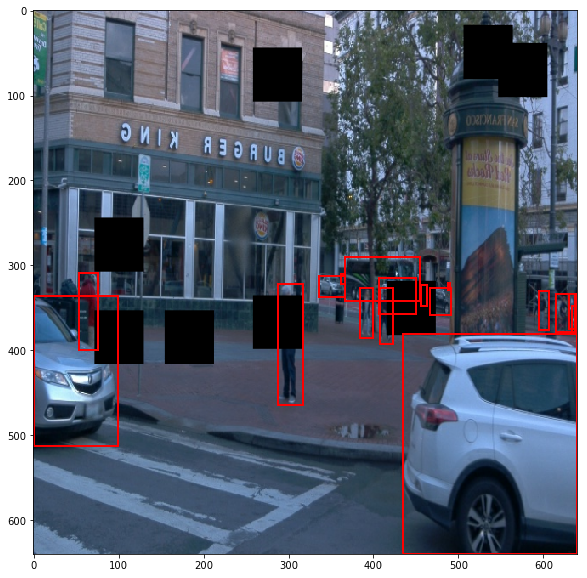

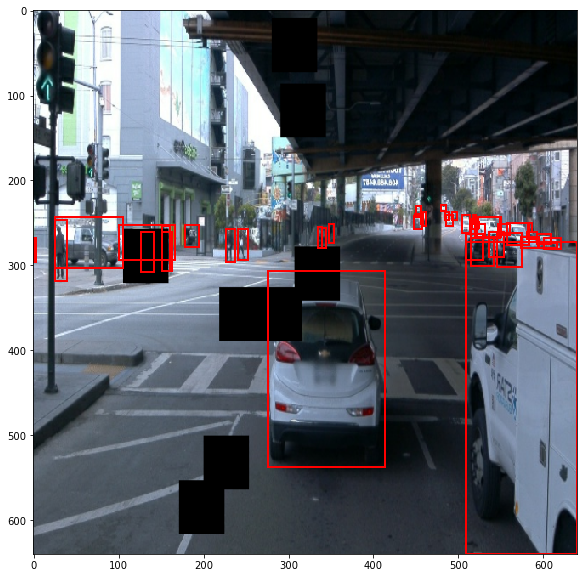

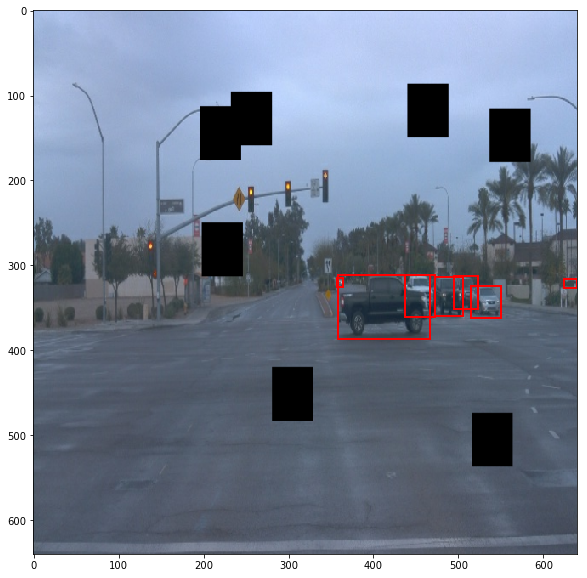

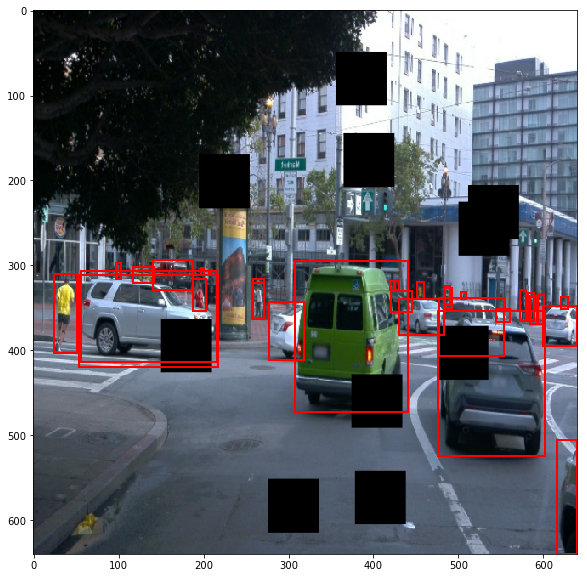

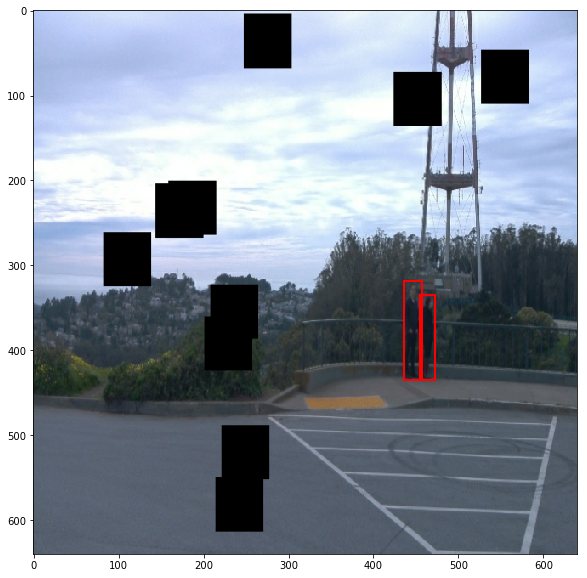

In [22]:
%matplotlib inline

for batch in experiments0.take(5):
    display_batch(batch)

## Experiment 1 Results

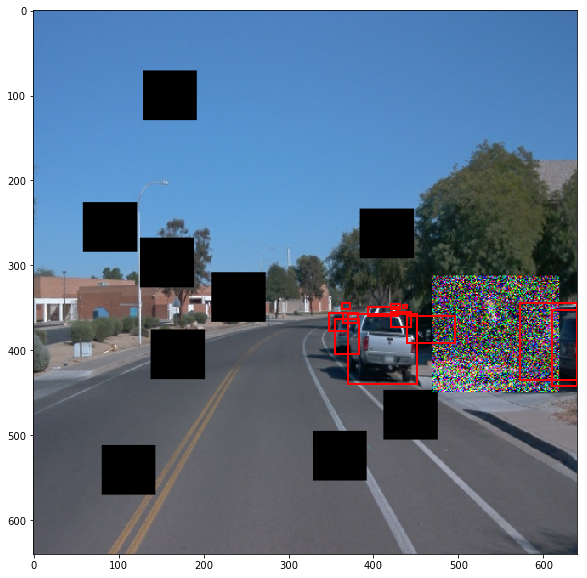

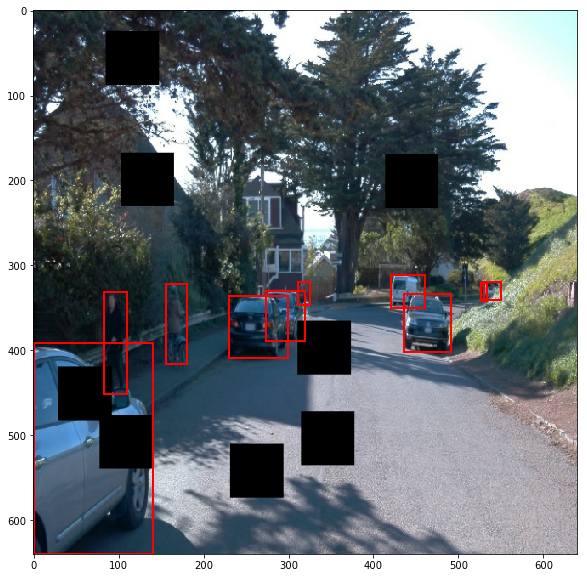

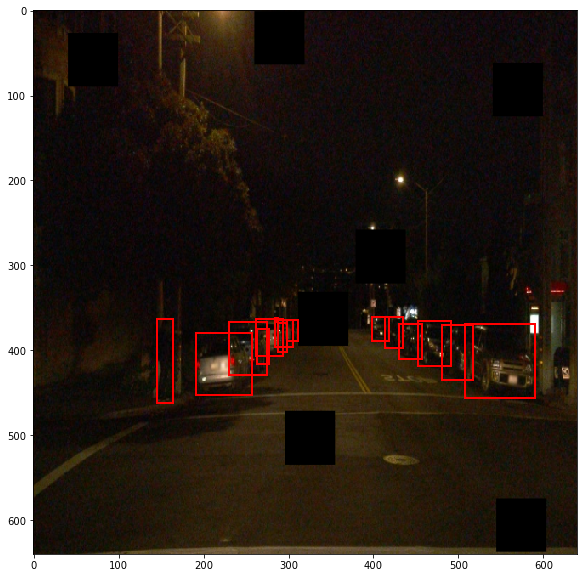

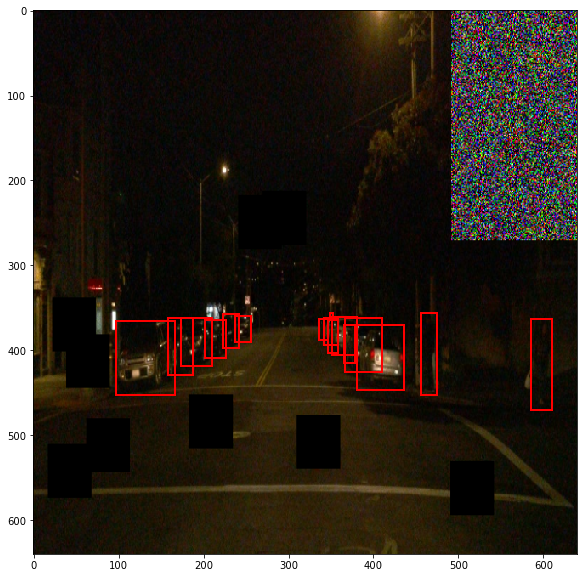

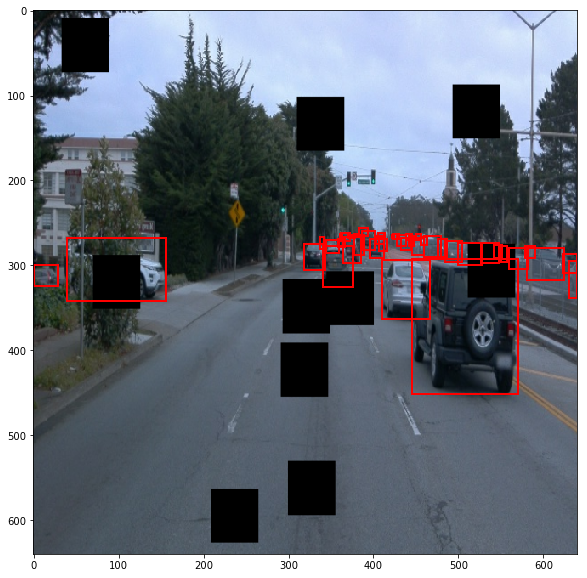

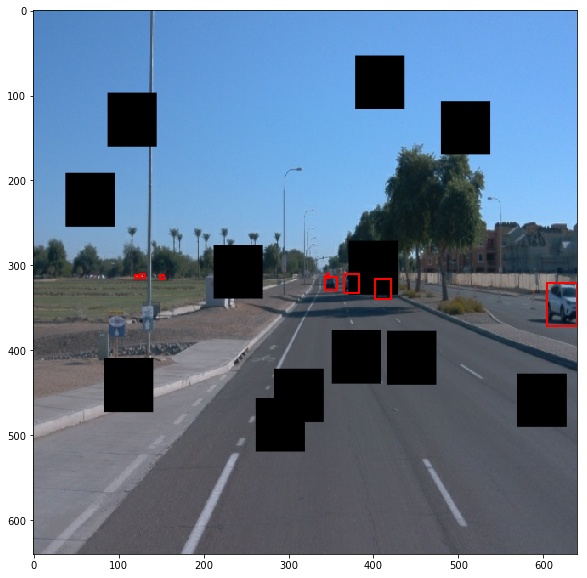

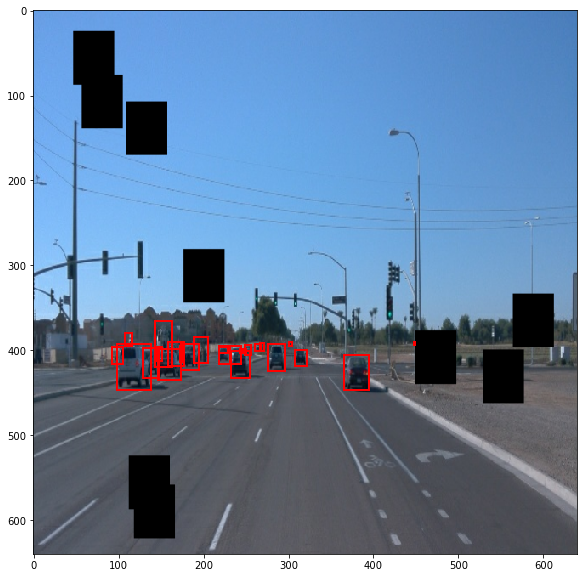

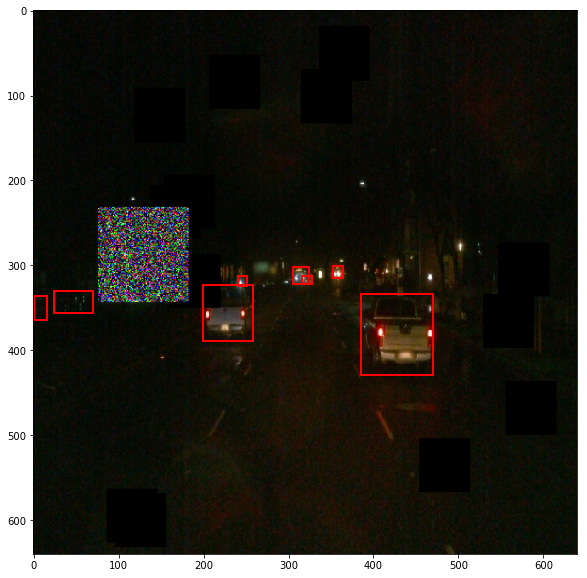

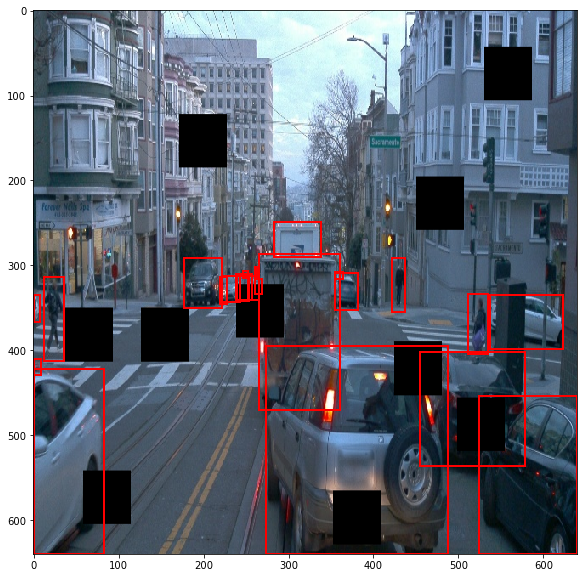

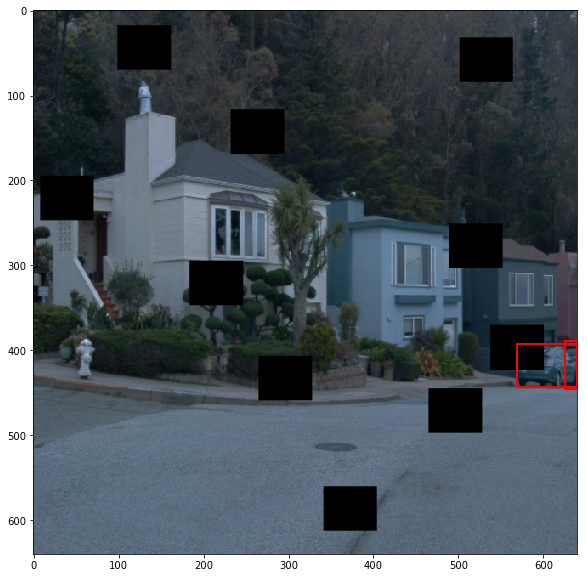

In [23]:
%matplotlib inline

for batch in experiments1.take(5):
    display_batch(batch)

## Experiment 2 Results

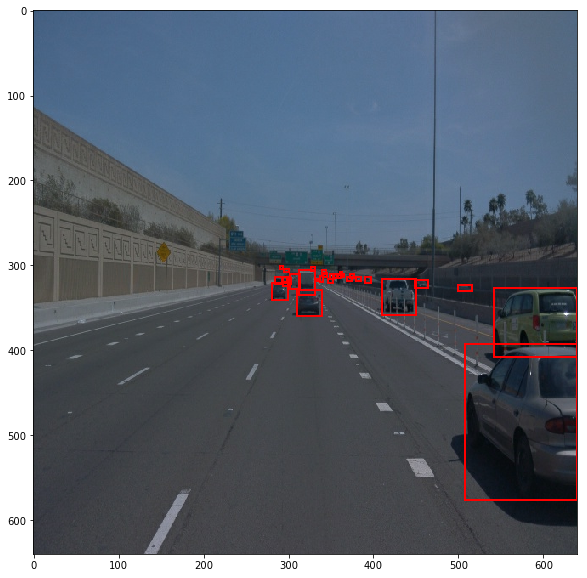

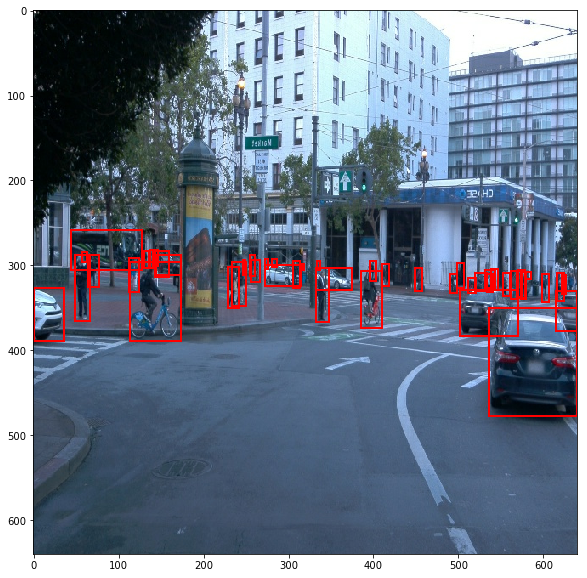

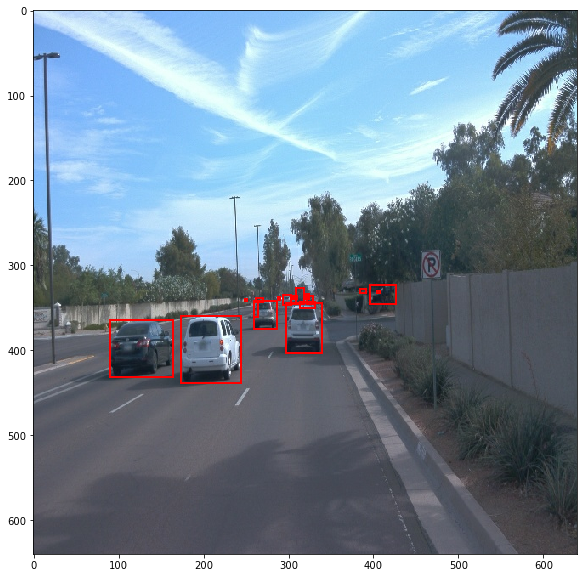

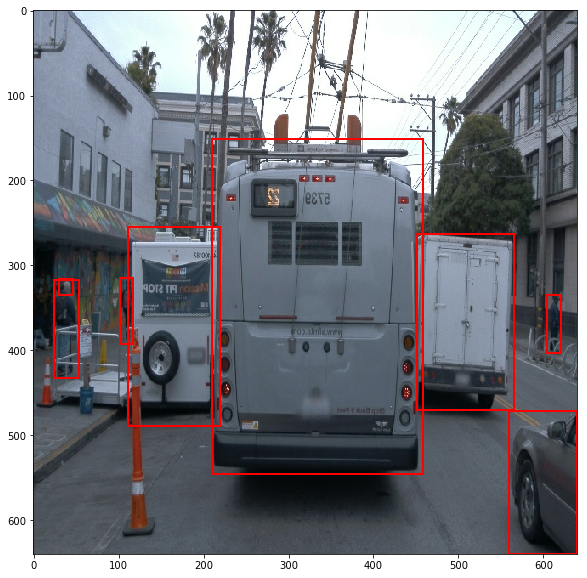

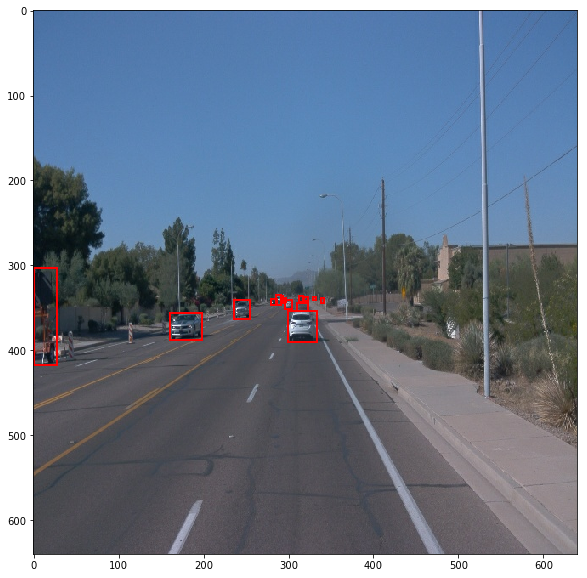

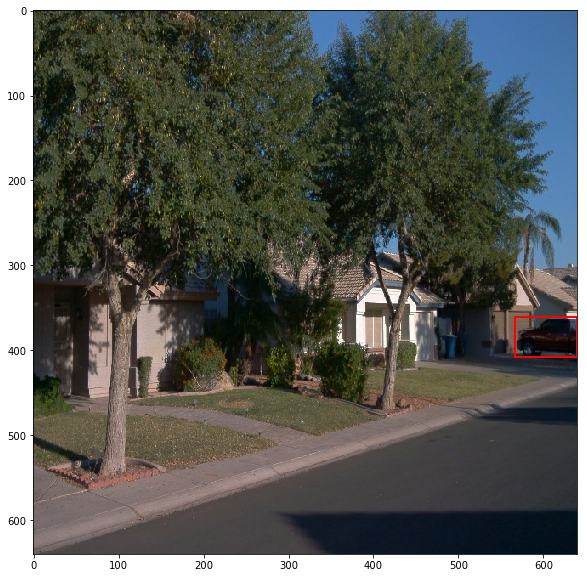

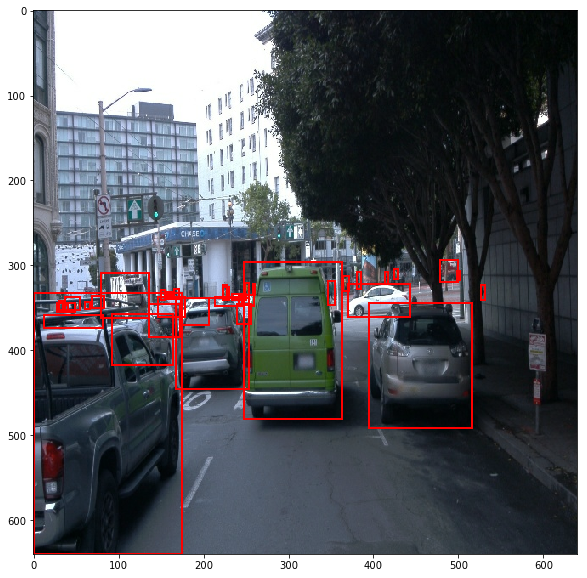

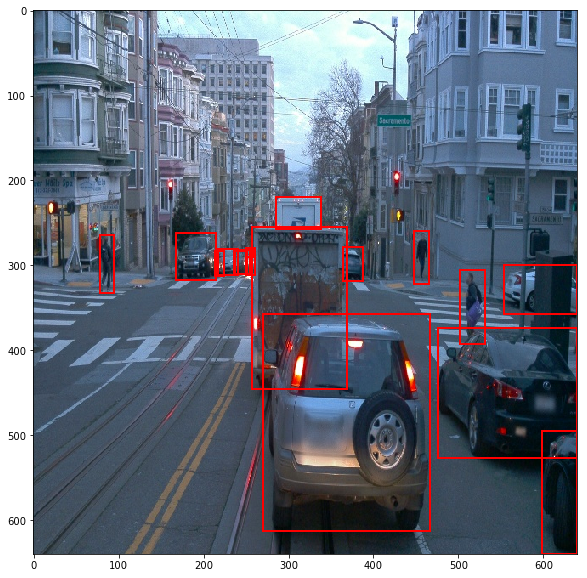

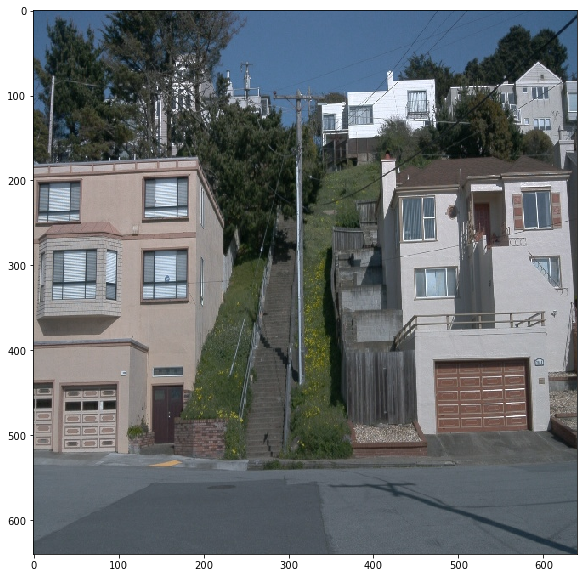

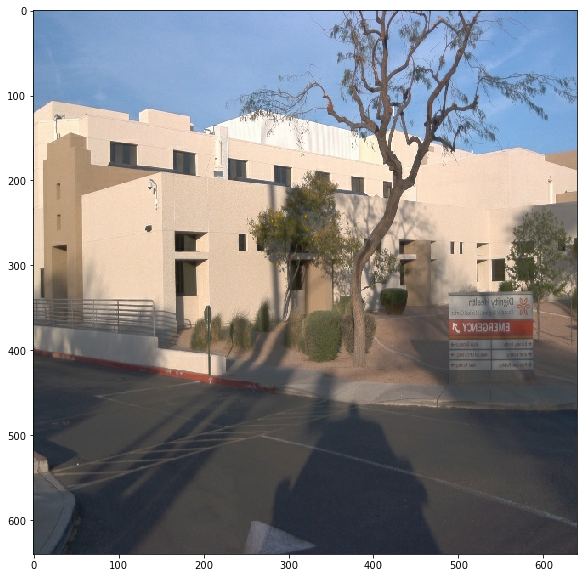

In [24]:
%matplotlib inline

for batch in experiments2.take(5):
    display_batch(batch)

## Experiment 3 Results

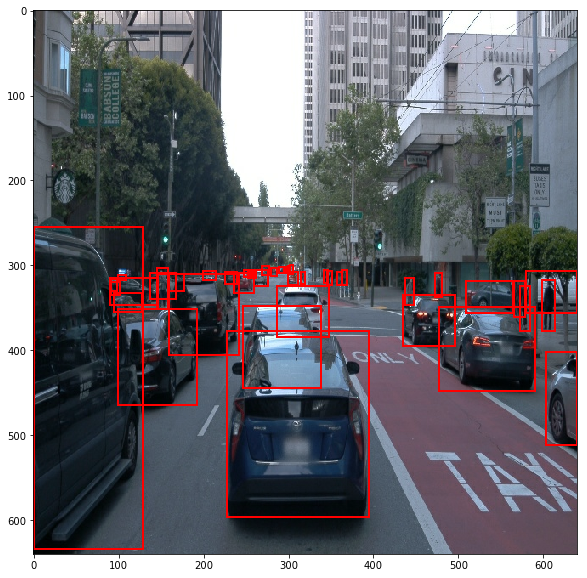

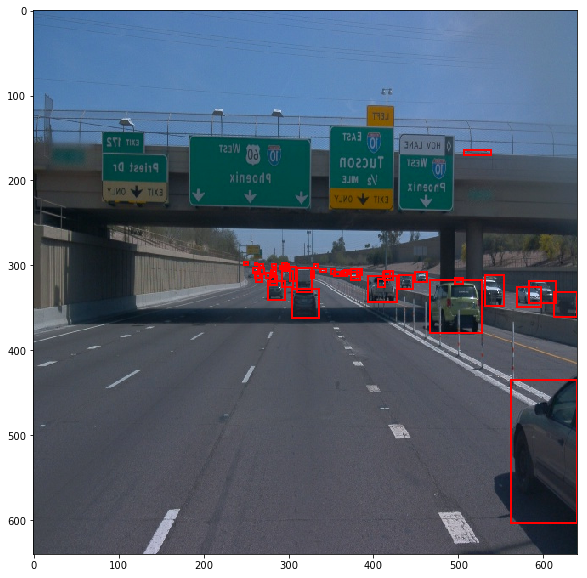

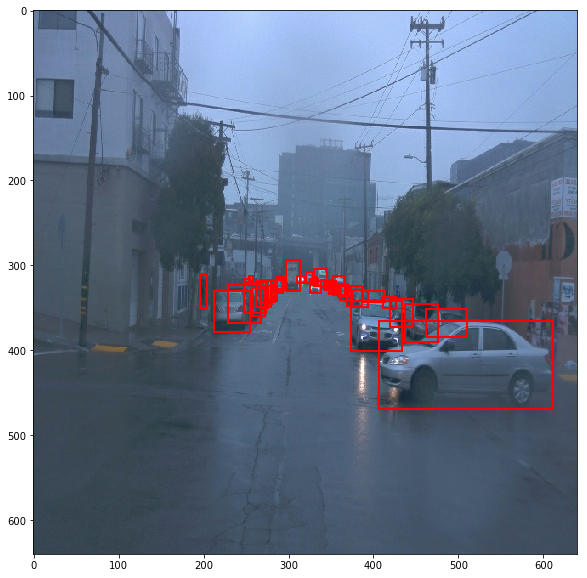

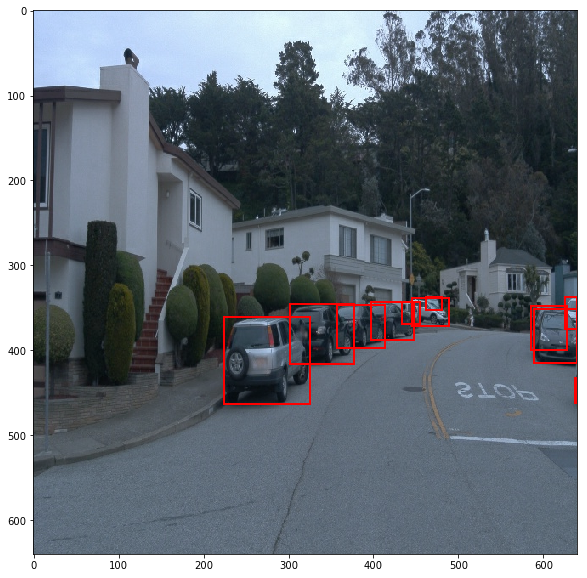

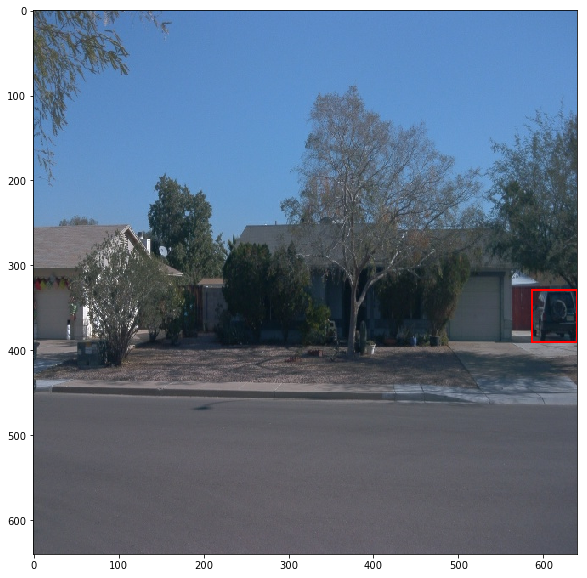

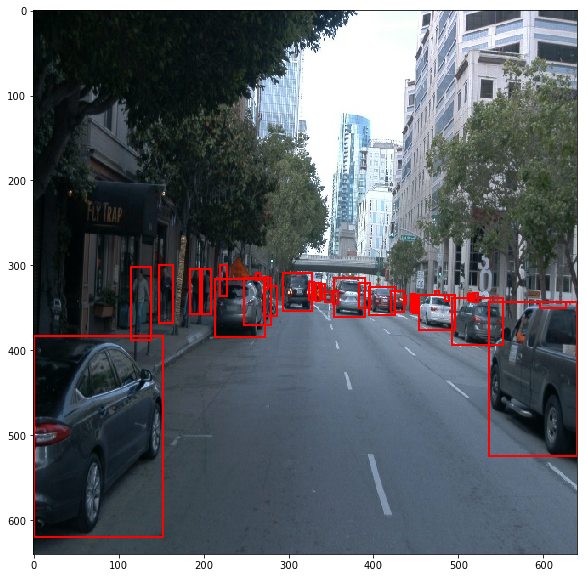

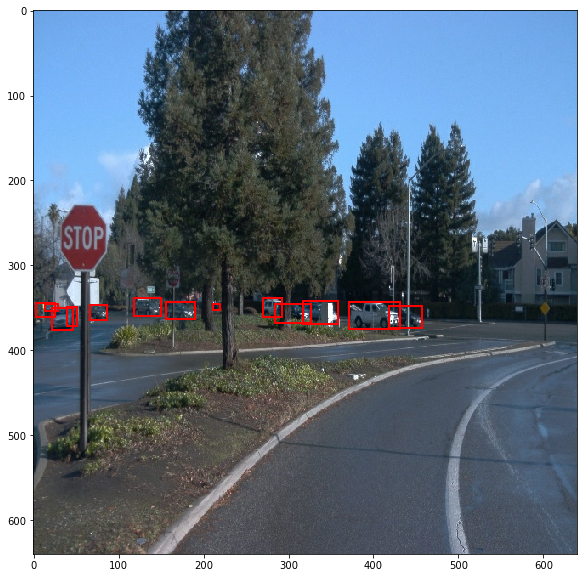

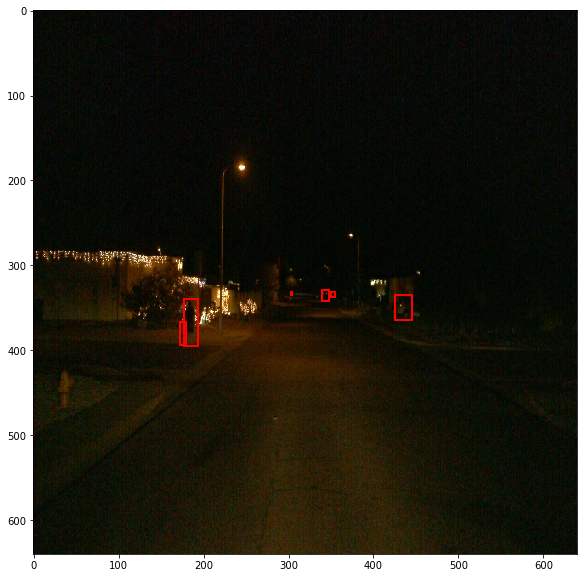

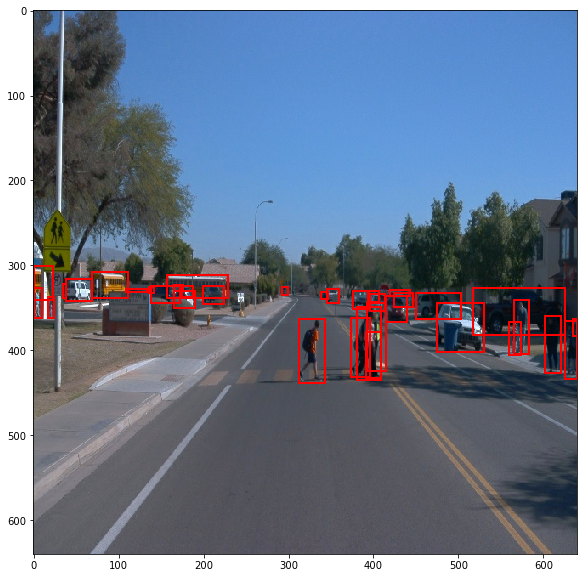

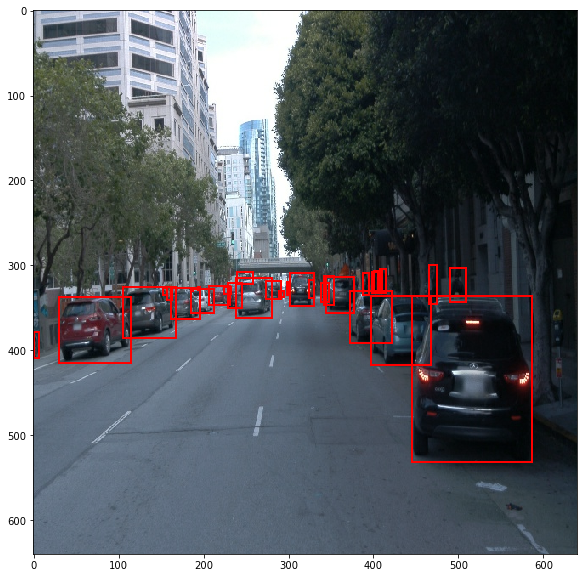

In [25]:
%matplotlib inline

for batch in experiments3.take(5):
    display_batch(batch)

## Experiment 4 Results

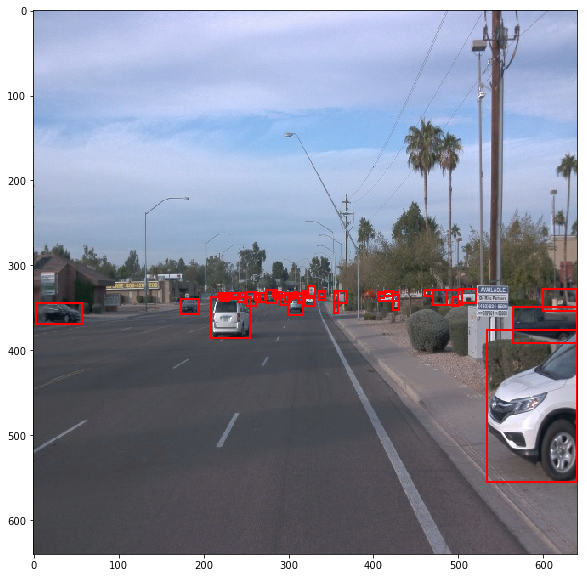

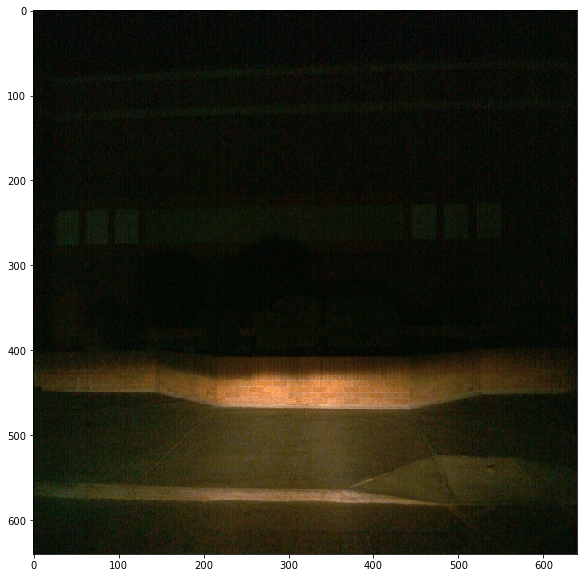

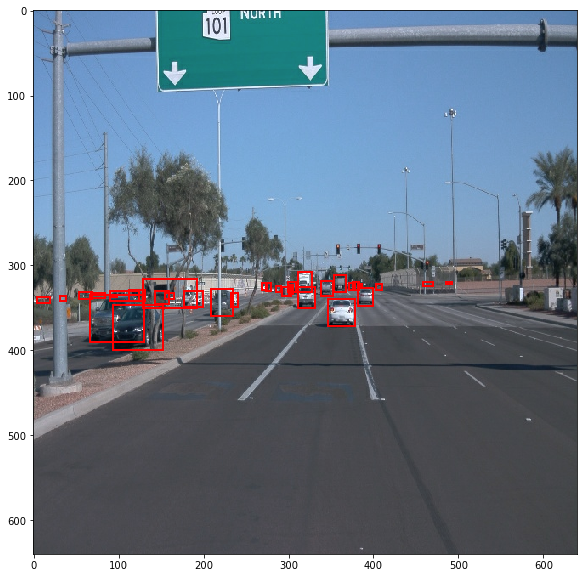

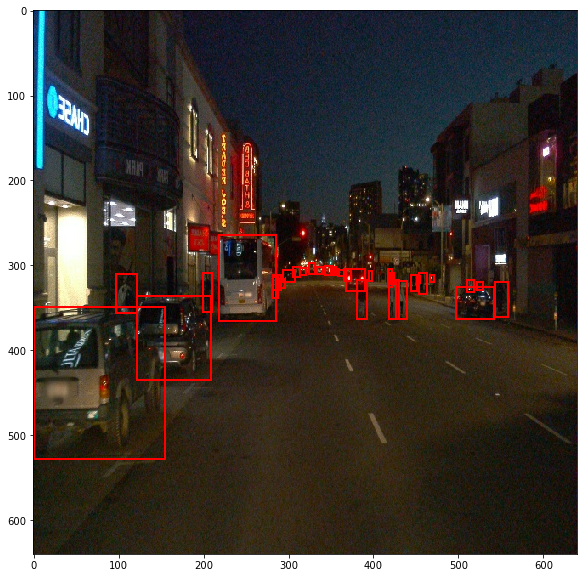

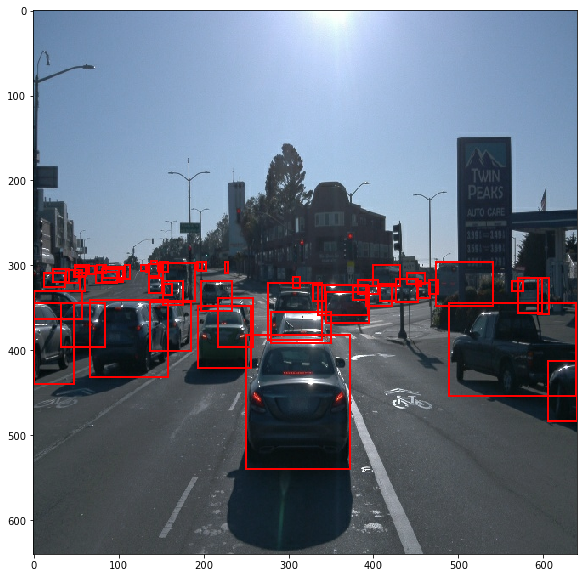

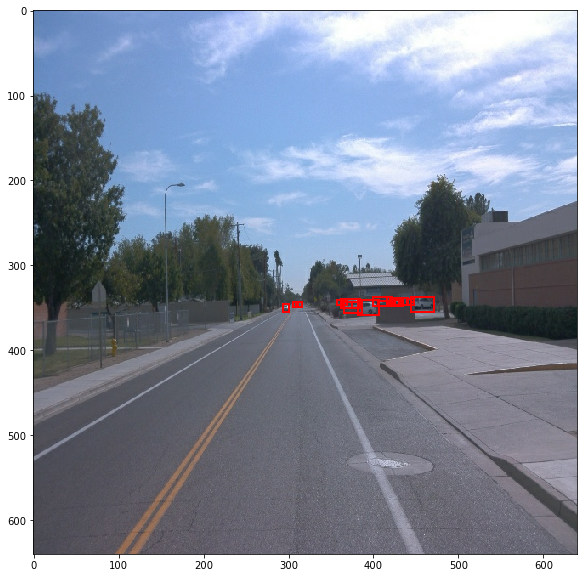

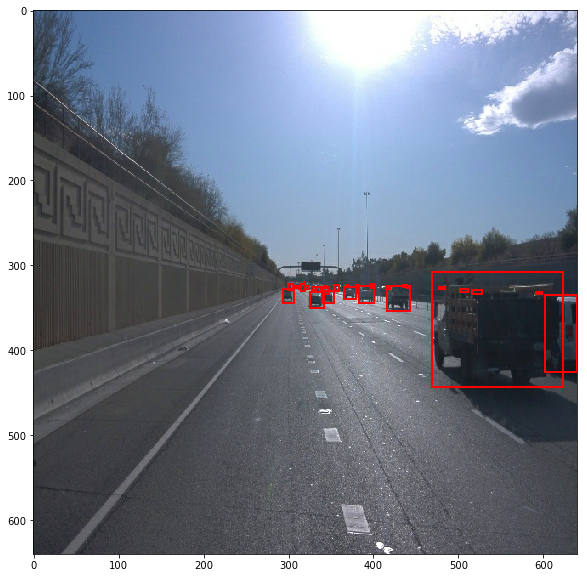

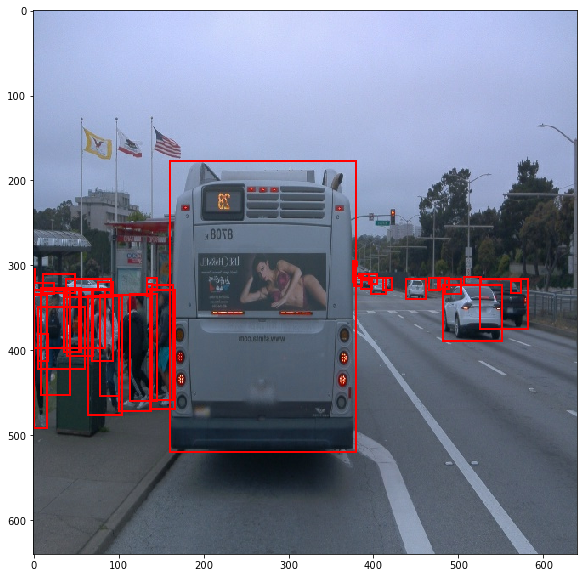

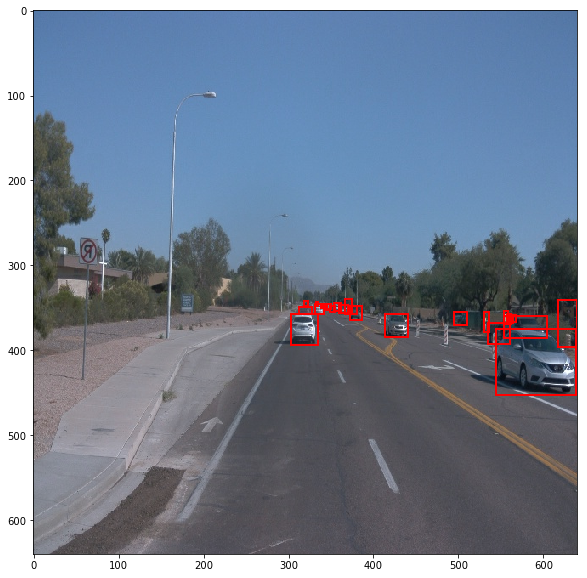

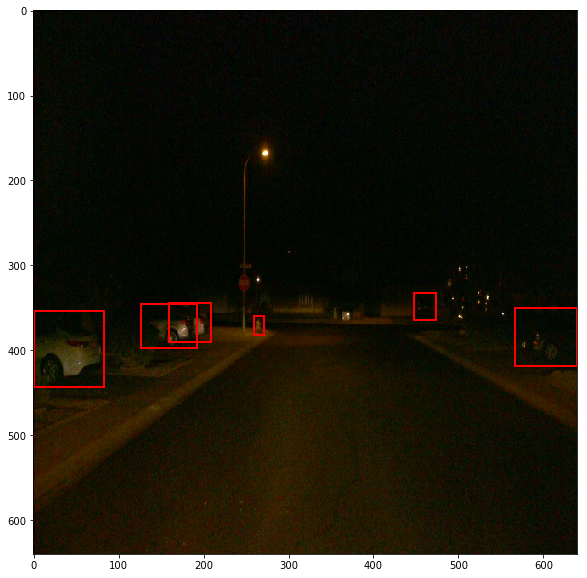

In [26]:
%matplotlib inline

for batch in experiments4.take(5):
    display_batch(batch)